<a href="https://colab.research.google.com/github/YounSooKimTech/Joy_Profile_Photos/blob/main/Tuck_Darthmouth.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
df_department =[]
df_name =[]
df_title =[]
df_link =[]

In [2]:
import pandas as pd
import requests
from bs4 import BeautifulSoup

departments = ["accounting", "economics", "finance", "marketing", "operations-management-science", "organizational-behavior", "strategy-and-management"]

for department in departments:
  url = f"https://www.tuck.dartmouth.edu/faculty/academic-groups/{department}/"
  response = requests.get(url)
  #print(url, response)
  soup = BeautifulSoup(response.content, 'html.parser')

  div_tag = soup.find("div", class_ = "large-10 large-centered columns")
  div_sub_tag = soup.find("div", class_="large-intro")
  p_tags = div_sub_tag.find_all("p")

  for p_tag in p_tags:
    p_tag_text = p_tag.get_text()
    name = p_tag_text.split("\n")[0]
    title = p_tag_text.split("\n")[-1]

    if title == "AFFILIATED FACULTY":
        continue  # Skip this entry

    href = p_tag.find("a")["href"].split("/")[-1]
    link = f"https://www.tuck.dartmouth.edu/faculty/faculty-directory/{href}"


    #print(department, name, title, href, "\n")
    df_department.append(department)
    df_name.append(name)
    df_title.append(title)
    df_link.append(link)


In [3]:
import pandas as pd

df_meta = pd.DataFrame({"Department":df_department,
                        "Name":df_name,
                        "Title":df_title,
                        "URL":df_link})

df_meta

,Department,Name,Title,URL
0,accounting,Joseph J. Gerakos D’90,Bakala Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...
1,accounting,Leslie A. Robinson,Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...
2,accounting,Richard C. Sansing,Noble Foundation Professor of Accounting,https://www.tuck.dartmouth.edu/faculty/faculty...
3,accounting,Phillip C. Stocken,Jack Byrne Professor of Accounting; Area Chair...,https://www.tuck.dartmouth.edu/faculty/faculty...
4,accounting,Thomas L. (Tom) Porter,Visiting Professor,https://www.tuck.dartmouth.edu/faculty/faculty...
...,...,...,...,...
67,strategy-and-management,Hart Posen,Professor of Strategy and Entrepreneurship; Fa...,https://www.tuck.dartmouth.edu/faculty/faculty...
68,strategy-and-management,Alva Taylor,"Faculty Director, Glassmeyer/McNamee Center fo...",https://www.tuck.dartmouth.edu/faculty/faculty...
69,strategy-and-management,Scott Anthony,Clinical Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...
70,strategy-and-management,Grant Freeland,Adjunct Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...


In [4]:
df_meta[df_meta["Title"].str.contains("Visiting|Clinical")]

,Department,Name,Title,URL
4,accounting,Thomas L. (Tom) Porter,Visiting Professor,https://www.tuck.dartmouth.edu/faculty/faculty...
5,accounting,Jordan Schoenfeld,Visiting Professor,https://www.tuck.dartmouth.edu/faculty/faculty...
24,finance,Anant K. Sundaram,Clinical Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...
25,finance,Karin S. Thorburn,Visiting Professor of Finance; Lindenauer Rese...,https://www.tuck.dartmouth.edu/faculty/faculty...
36,marketing,Dean Alderucci,Visiting Professor,https://www.tuck.dartmouth.edu/faculty/faculty...
37,marketing,Gail Ayala Taylor,Clinical Professor of Business Administration;...,https://www.tuck.dartmouth.edu/faculty/faculty...
39,operations-management-science,Joseph M. Hall,Senior Associate Dean for Teaching and Learnin...,https://www.tuck.dartmouth.edu/faculty/faculty...
57,organizational-behavior,Stacy Blake-Beard,Clinical Professor,https://www.tuck.dartmouth.edu/faculty/faculty...
58,organizational-behavior,Aram Donigian T'08,Clinical Professor,https://www.tuck.dartmouth.edu/faculty/faculty...
69,strategy-and-management,Scott Anthony,Clinical Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...


In [5]:
df_meta_prof = df_meta[~df_meta["Title"].str.contains("Visiting|Clinical|Adjunct")]

In [6]:
df_meta.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 72 entries, 0 to 71
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Department  72 non-null     object
 1   Name        72 non-null     object
 2   Title       72 non-null     object
 3   URL         72 non-null     object
dtypes: object(4)
memory usage: 2.4+ KB


In [7]:
df_meta_prof.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 56 entries, 0 to 68
Data columns (total 4 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   Department  56 non-null     object
 1   Name        56 non-null     object
 2   Title       56 non-null     object
 3   URL         56 non-null     object
dtypes: object(4)
memory usage: 2.2+ KB


## Sex

In [8]:
prof_text = []
prof_name = []

for index, row in df_meta_prof.iterrows():
  name = row["Name"]
  url = row["URL"]

  response = requests.get(url)
  #print(url, response)
  soup = BeautifulSoup(response.content, 'html.parser')

  div_tag = soup.find("div", class_="large-8 medium-8 columns bio")
  p_tag = div_tag.find("p")

  text = p_tag.get_text().strip()
  prof_text.append(text)
  prof_name.append(name)
  #print(text, "\n")


In [9]:
df_text = pd.DataFrame({"Name":prof_name,
                       "Biography":prof_text})

import spacy
nlp = spacy.load('en_core_web_sm')

pronouns_list = []

for text in df_text['Biography']:
    doc = nlp(text)
    pronouns = [token.text.lower() for token in doc if token.pos_ == 'PRON' and token.text.lower() in ['he', 'she', 'her', 'his']]
    pronouns_list.append(pronouns)

df_text['Pronouns'] = pronouns_list

def determine_sex(pronouns):
    if 'he' in pronouns or 'his' in pronouns:
        return 'Male'
    elif 'she' in pronouns or 'her' in pronouns:
        return 'Female'
    else:
        return 'Unknown'

df_text['Sex'] = df_text['Pronouns'].apply(determine_sex)

#df_text[["Pronouns", "Sex"]]

In [10]:
df_meta_prof2 = df_meta_prof.merge(df_text, on = "Name")

In [11]:
# https://cepr.org/about/people/davin-chor
# https://faculty.tuck.dartmouth.edu/jonathan-lewellen/
# https://faculty.tuck.dartmouth.edu/katharina-lewellen/
# https://faculty.tuck.dartmouth.edu/felipe-severino/
# https://faculty.tuck.dartmouth.edu/scott-neslin/
# https://jimsmith.host.dartmouth.edu/bio/
# https://faculty.tuck.dartmouth.edu/ella-bell/
# https://digitalstrategies.tuck.dartmouth.edu/people/core-team/alva-h-taylor/

df_meta_prof2.loc[df_meta_prof2["Name"] == "Davin Chor", "Sex"] = "Male"
df_meta_prof2.loc[df_meta_prof2["Name"] == "Jonathan W. Lewellen", "Sex"] = "Male"

df_meta_prof2.loc[df_meta_prof2["Name"] == "Katharina Lewellen", "Sex"] = "Female"
df_meta_prof2.loc[df_meta_prof2["Name"] == "Felipe Severino", "Sex"] = "Male"

df_meta_prof2.loc[df_meta_prof2["Name"] == "Scott A. Neslin", "Sex"] = "Male"

df_meta_prof2.loc[df_meta_prof2["Name"] == "James Smith", "Sex"] = "Male"
df_meta_prof2.loc[df_meta_prof2["Name"] == "Ella L.J. Smith", "Sex"] = "Female"

df_meta_prof2.loc[df_meta_prof2["Name"] == "Alva Taylor", "Sex"] = "Male"

In [12]:
df_meta_prof2[df_meta_prof2["Sex"] == "Unknown"]

,Department,Name,Title,URL,Biography,Pronouns,Sex


# Profile Photos

In [13]:
from google.colab import files

photo_name = []
filenames = []

for index, row in df_meta_prof2.iterrows():
  name = row["Name"]
  url = row["URL"]

  newname = name.lower().replace(".", "").replace(" ", "_")
  filename = f"{newname}.jpg"
  filenames.append(filename)
  photo_name.append(name)

  response = requests.get(url)
  #print(url, response)
  soup = BeautifulSoup(response.content, 'html.parser')

  # photo tag
  div_tag = soup.find("div", class_="large-4 medium-4 columns medium-text-right")
  img_tag = div_tag.find("img")
  img_src = img_tag["src"]
  img_link = f"https://www.tuck.dartmouth.edu/{img_src}"

  if img_link:
    flag = requests.get(img_link)

    with open(filename, "wb") as f:
        noop = f.write(flag.content)
        print(f"saved the {filename}")

        #files.download(filename)
        #print(f"download the {filename}")




saved the joseph_j_gerakos_d’90.jpg
saved the leslie_a_robinson.jpg
saved the richard_c_sansing.jpg
saved the phillip_c_stocken.jpg
saved the andrew_b_bernard.jpg
saved the emily_j_blanchard.jpg
saved the davin_chor.jpg
saved the teresa_fort.jpg
saved the robert_g_hansen.jpg
saved the erin_mansur.jpg
saved the felix_montag.jpg
saved the matthew_j_slaughter.jpg
saved the b_espen_eckbo.jpg
saved the kenneth_r_french.jpg
saved the franz_j_hinzen.jpg
saved the jonathan_w_lewellen.jpg
saved the katharina_lewellen.jpg
saved the juhani_linnainmaa.jpg
saved the brian_melzer.jpg
saved the gordon_phillips.jpg
saved the felipe_severino.jpg
saved the morten_sorensen.jpg
saved the kusum_l_ailawadi.jpg
saved the peter_n_golder.jpg
saved the lauren_grewal.jpg
saved the kevin_lane_keller.jpg
saved the punam_anand_keller.jpg
saved the praveen_k_kopalle.jpg
saved the scott_a_neslin.jpg
saved the nailya_ordabayeva.jpg
saved the sharmistha_sikdar.jpg
saved the prasad_vana.jpg
saved the laurens_debo.jpg
sa

In [14]:
df_temp = pd.DataFrame({"Name":photo_name,
                        "Filename":filenames})

df_temp.head()

,Name,Filename
0,Joseph J. Gerakos D’90,joseph_j_gerakos_d’90.jpg
1,Leslie A. Robinson,leslie_a_robinson.jpg
2,Richard C. Sansing,richard_c_sansing.jpg
3,Phillip C. Stocken,phillip_c_stocken.jpg
4,Andrew B. Bernard,andrew_b_bernard.jpg


# Smile Detection

Leslie A. Robinson


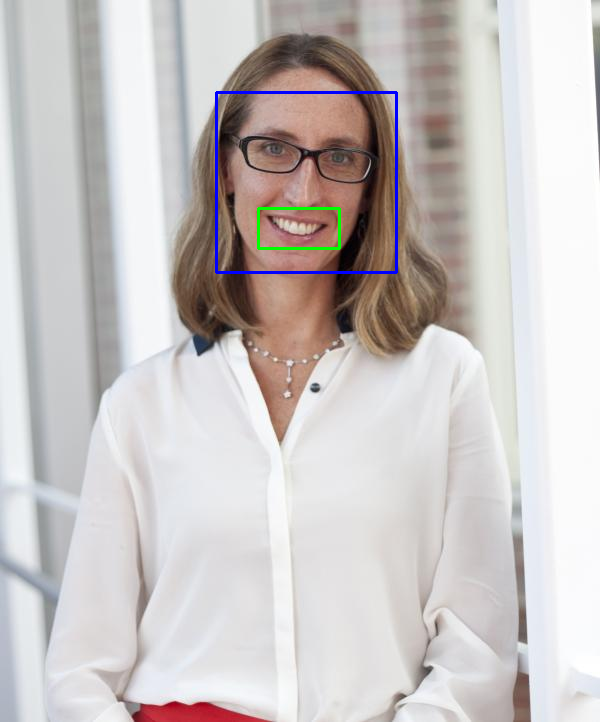

Richard C. Sansing


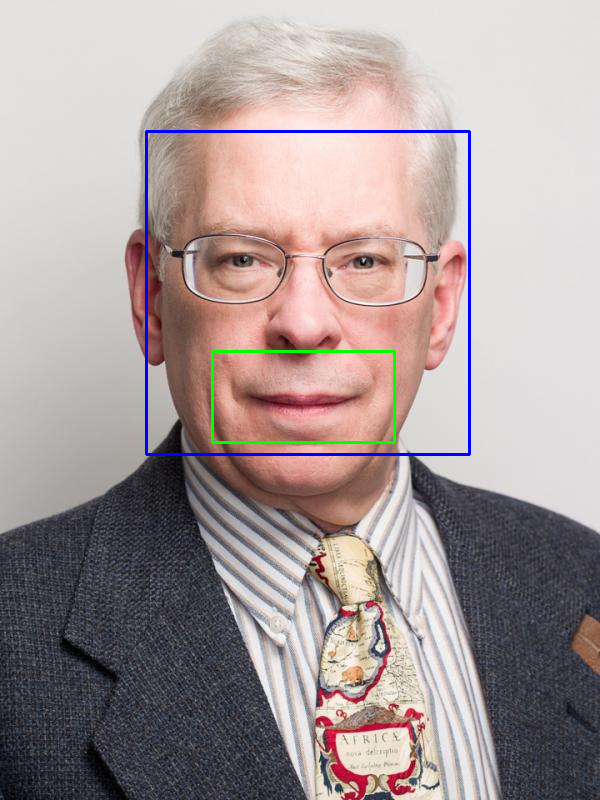

Phillip C. Stocken


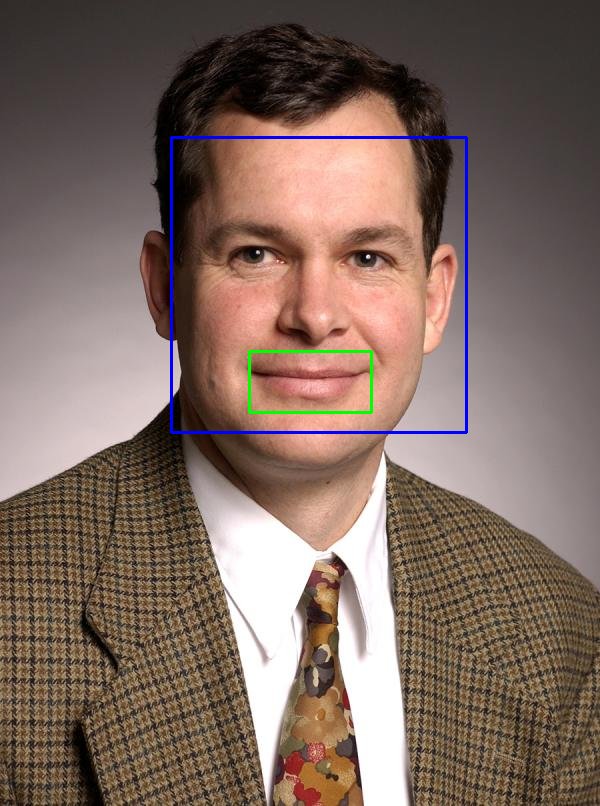

Andrew B. Bernard


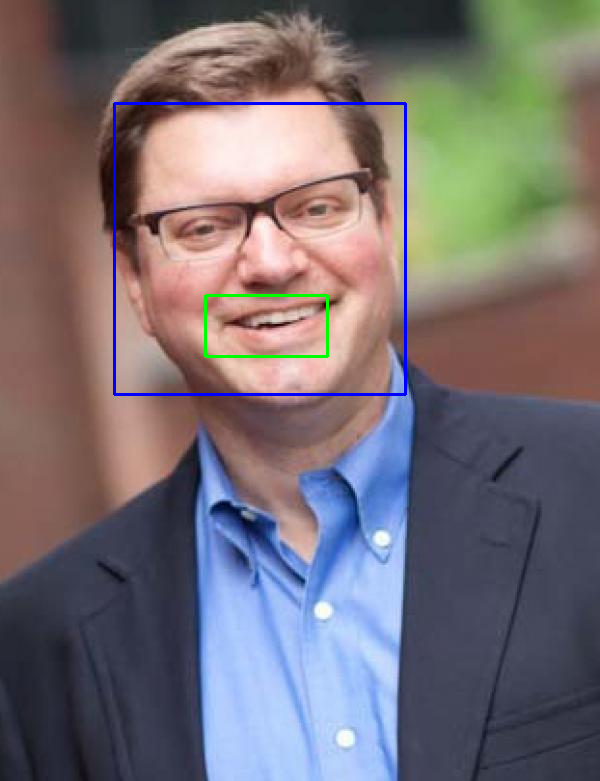

Emily J. Blanchard


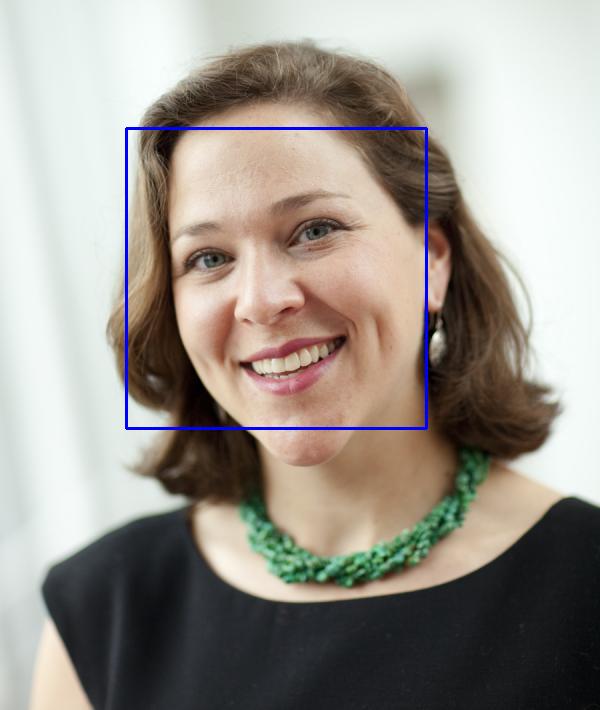

Davin Chor


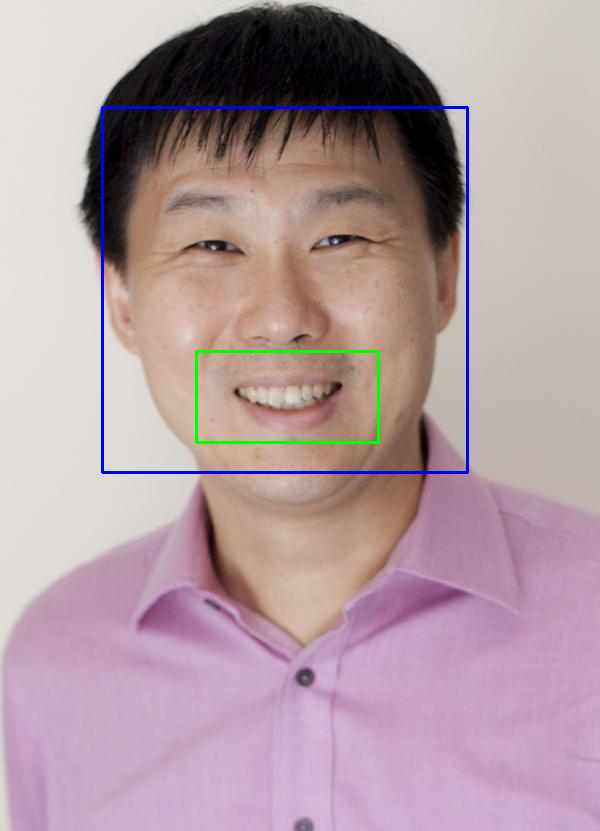

Teresa Fort


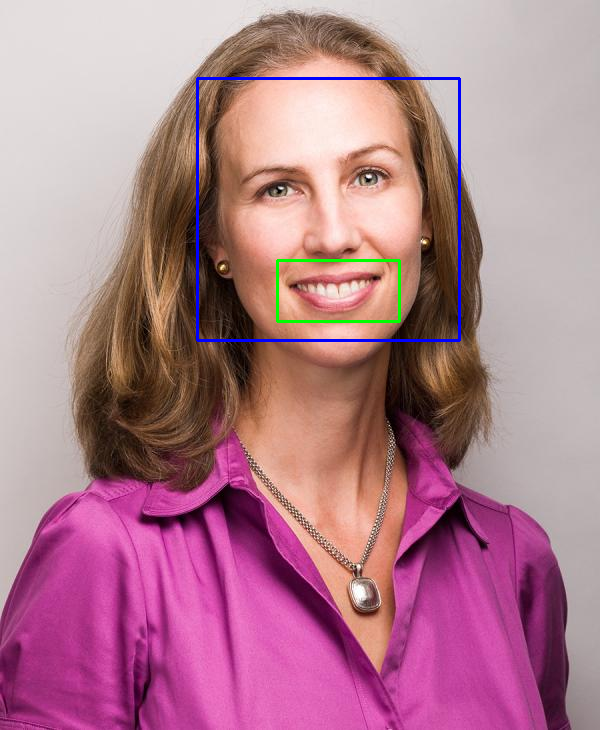

Robert G. Hansen


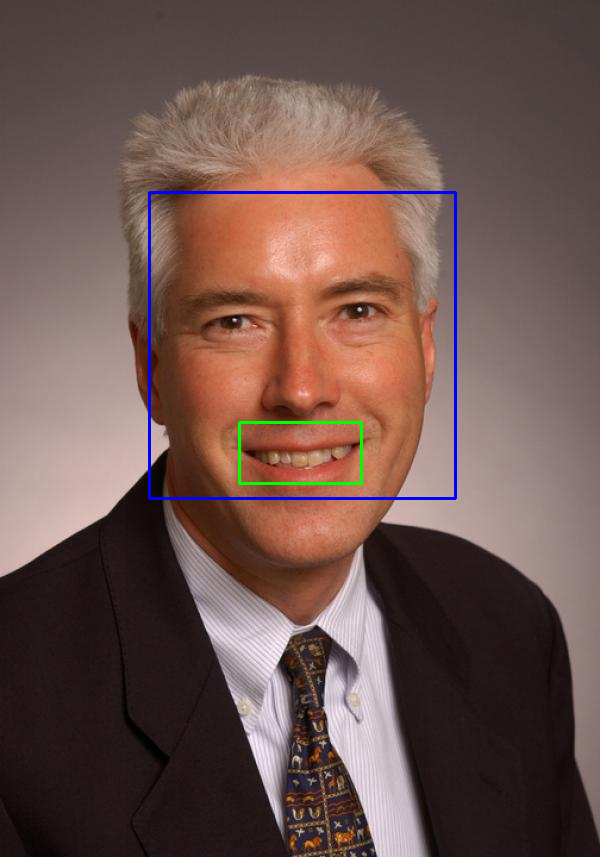

Erin Mansur


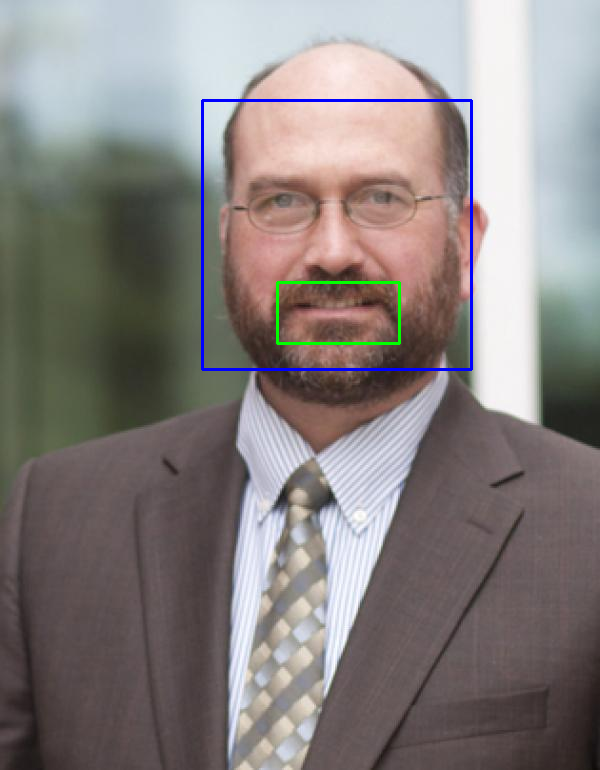

Felix Montag


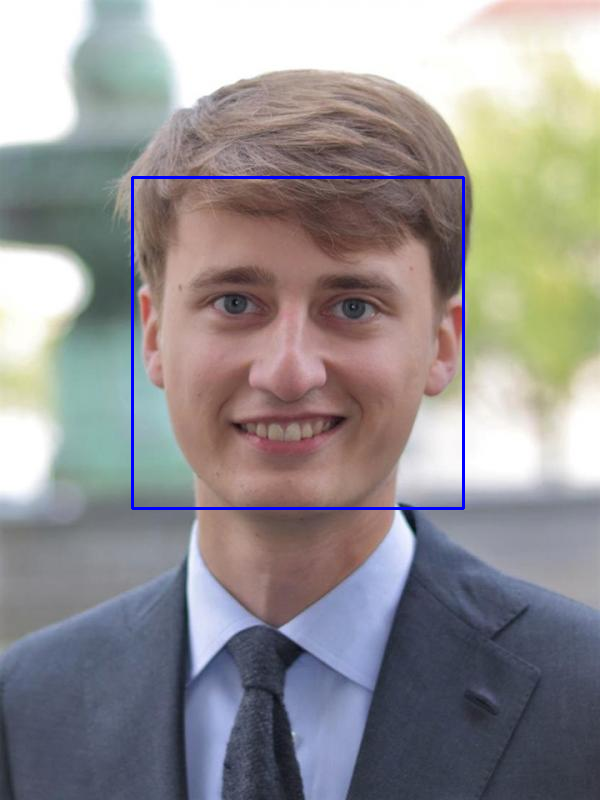

Matthew J. Slaughter


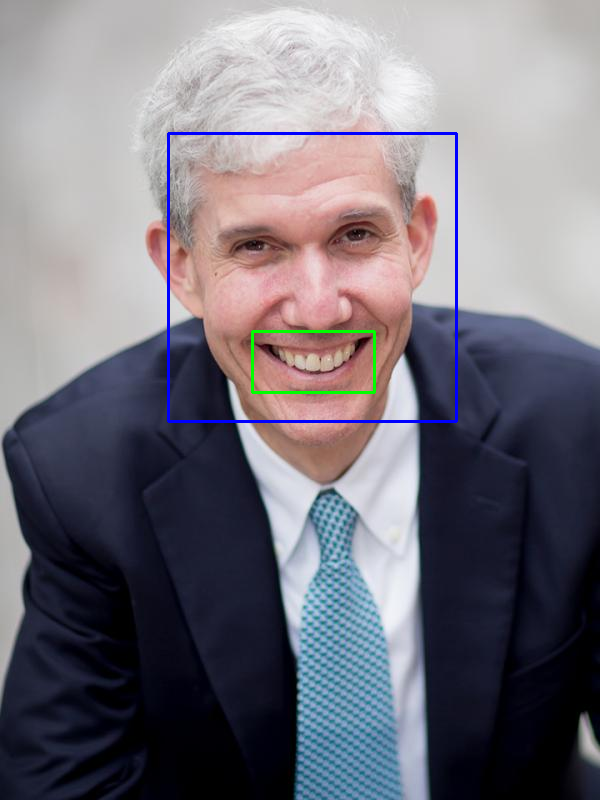

B. Espen Eckbo


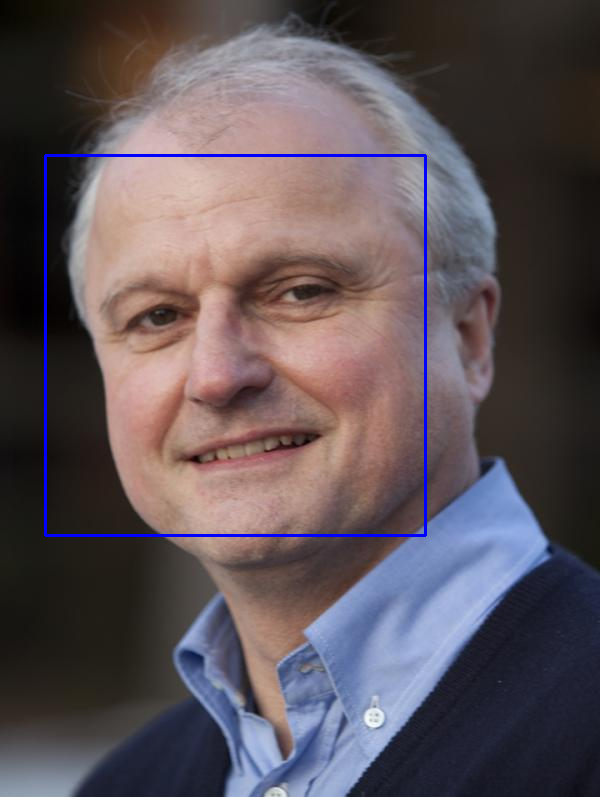

Kenneth R. French


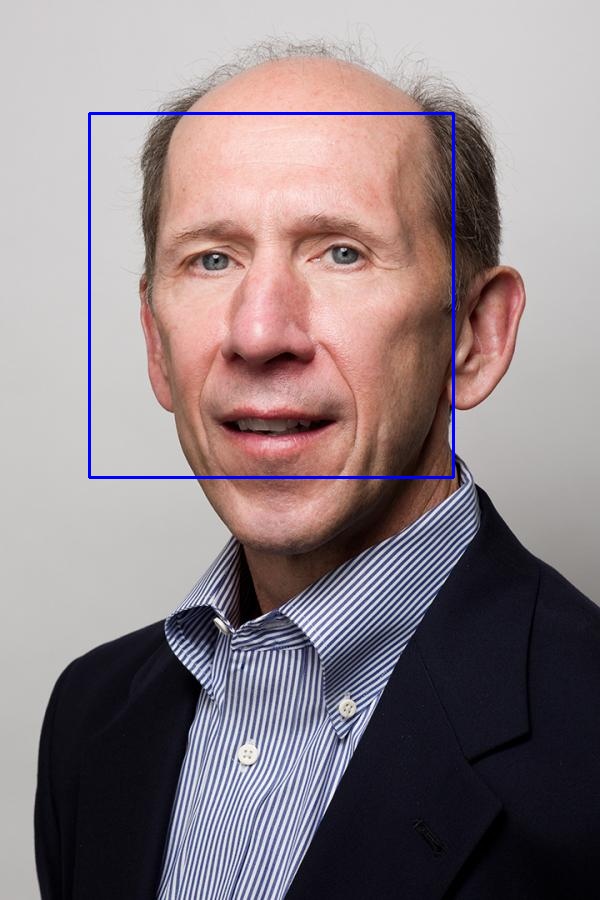

Franz J. Hinzen


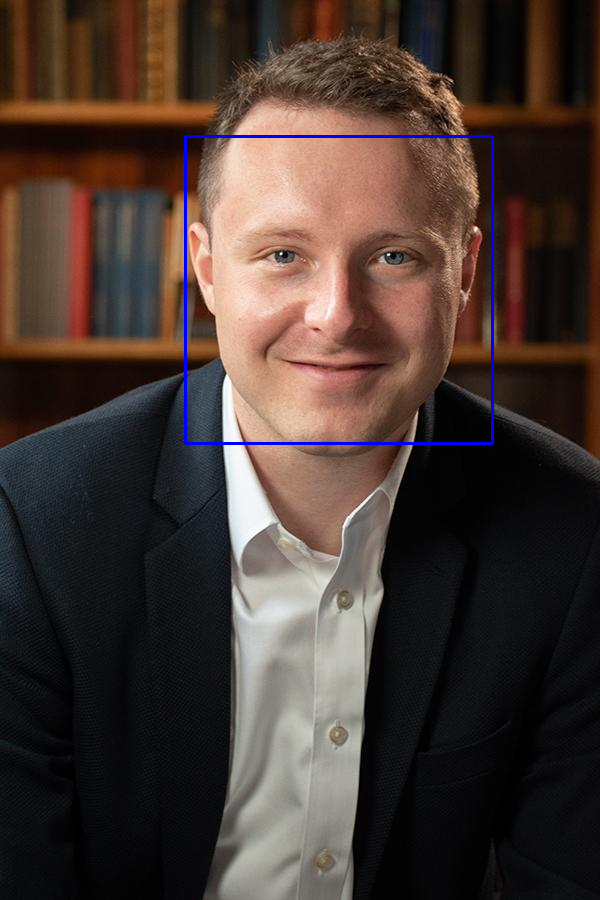

Jonathan W. Lewellen


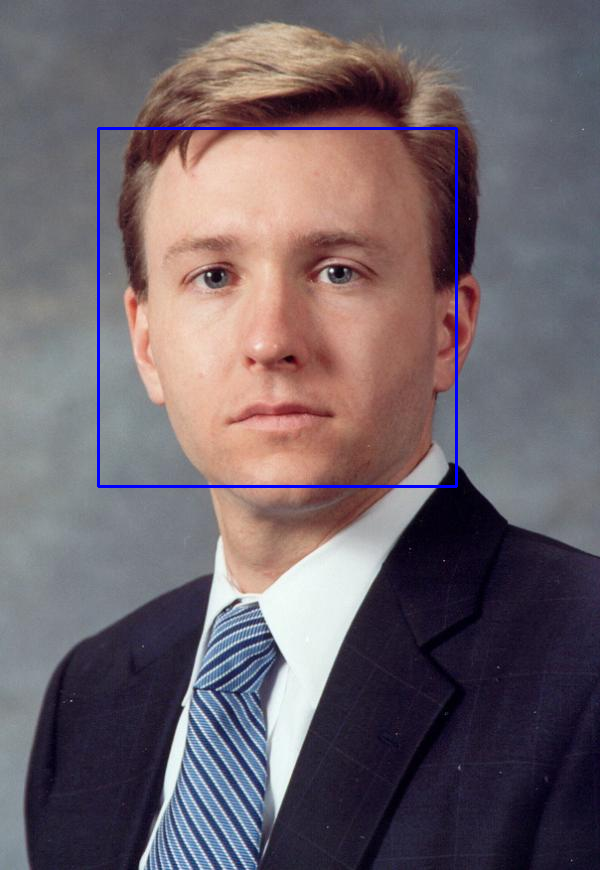

Katharina Lewellen


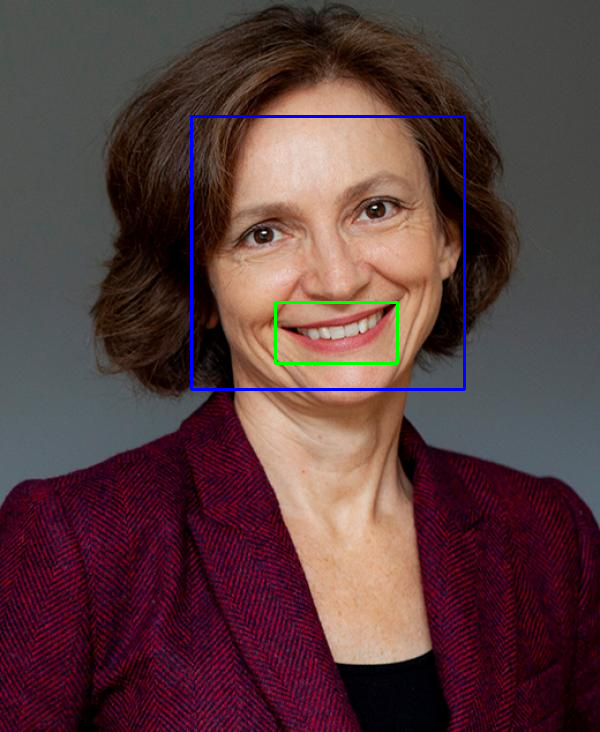

Juhani Linnainmaa


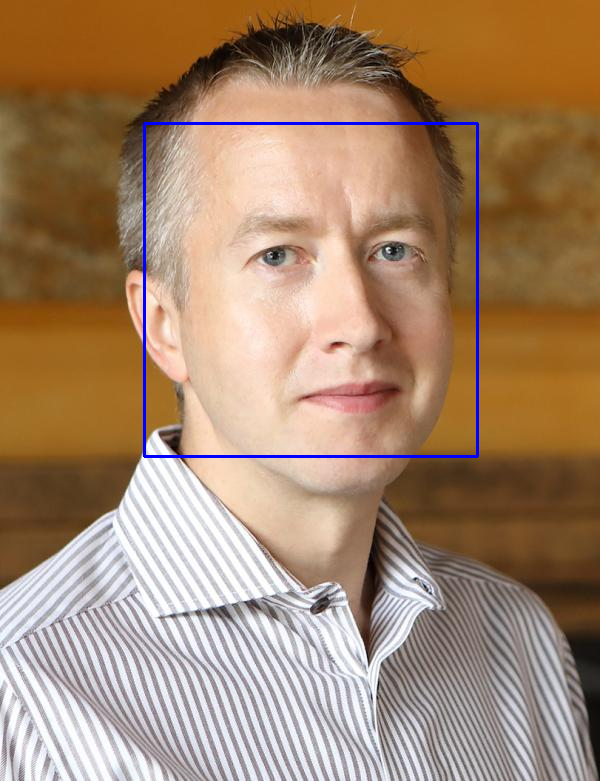

Brian Melzer


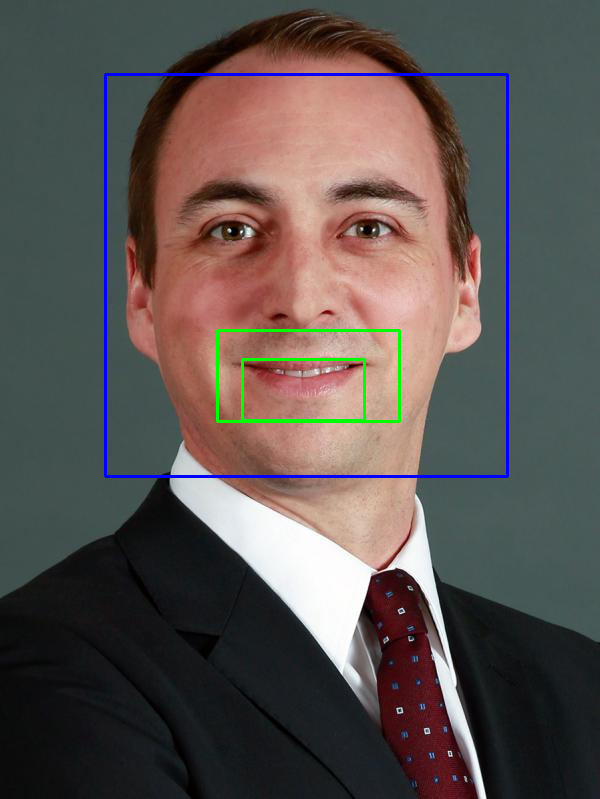

Gordon Phillips


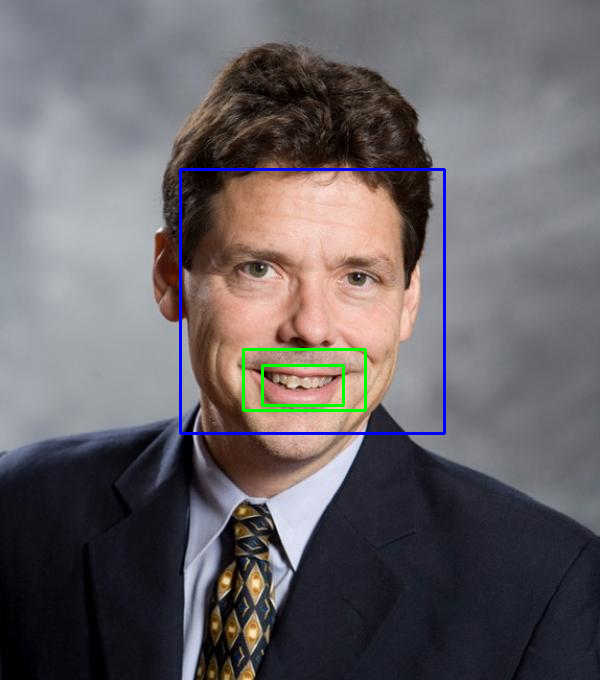

Felipe Severino


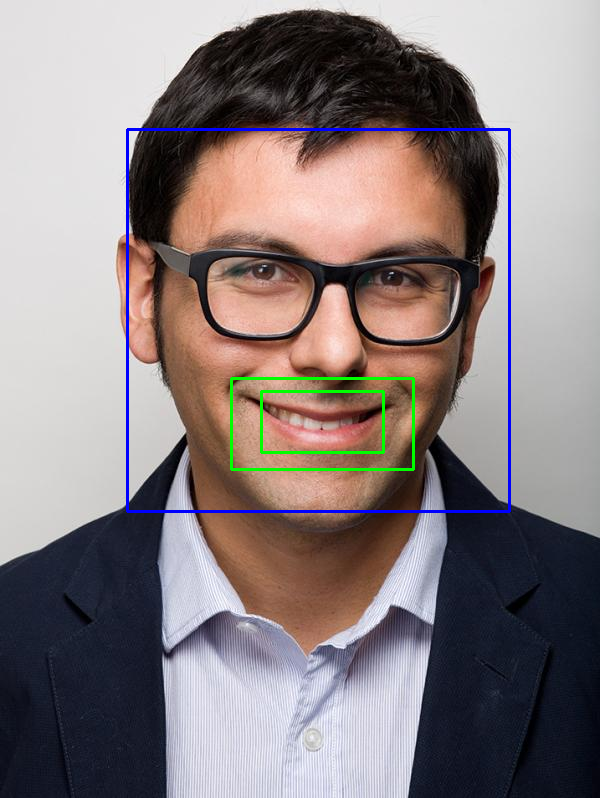

Morten Sorensen


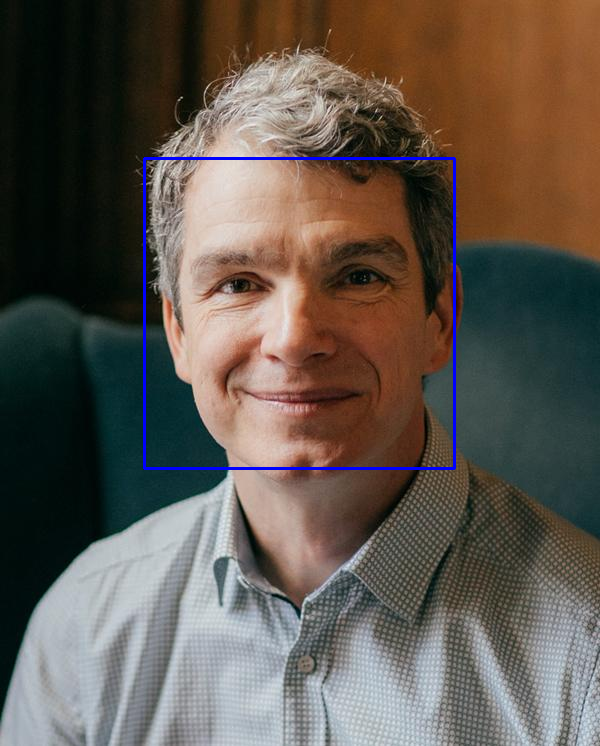

Kusum L. Ailawadi


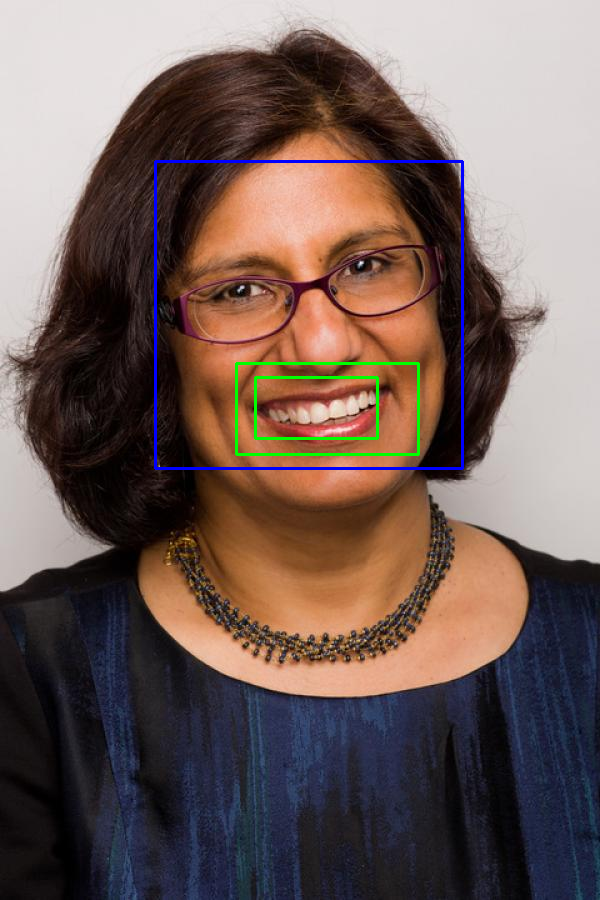

Peter N. Golder


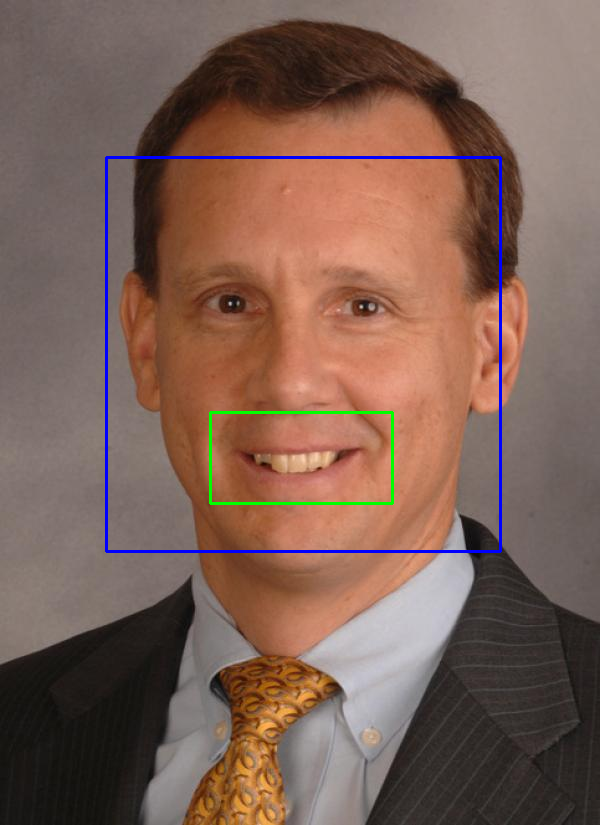

Lauren Grewal


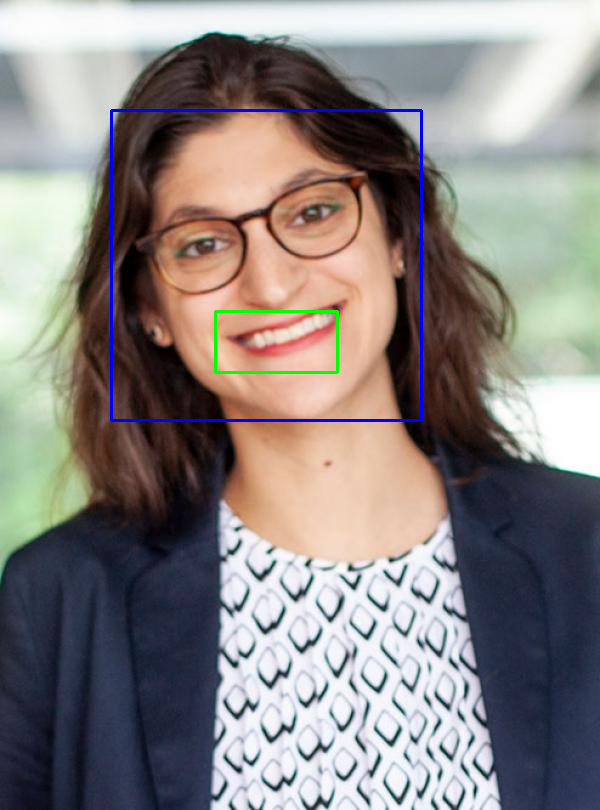

Kevin Lane Keller


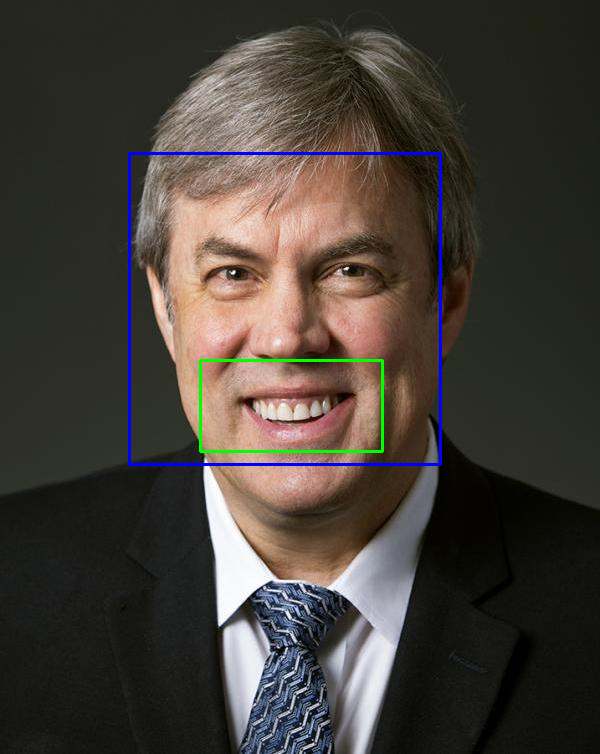

Punam Anand Keller


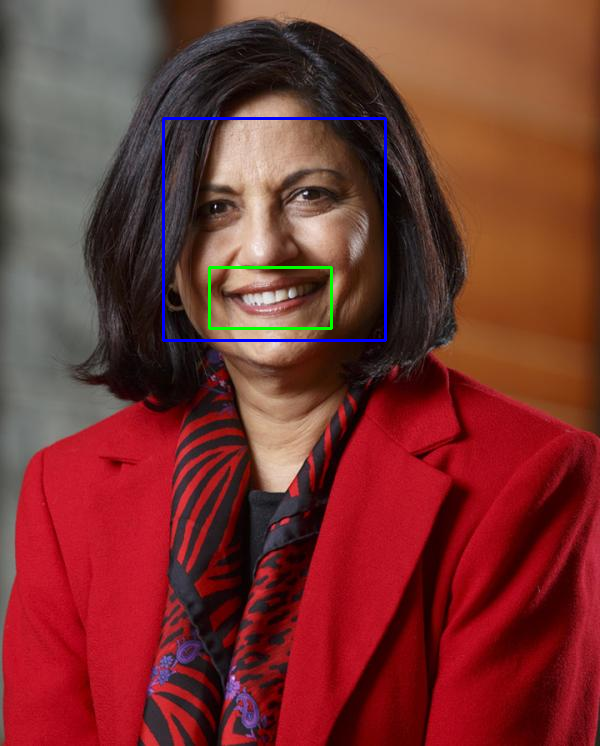

Praveen K. Kopalle


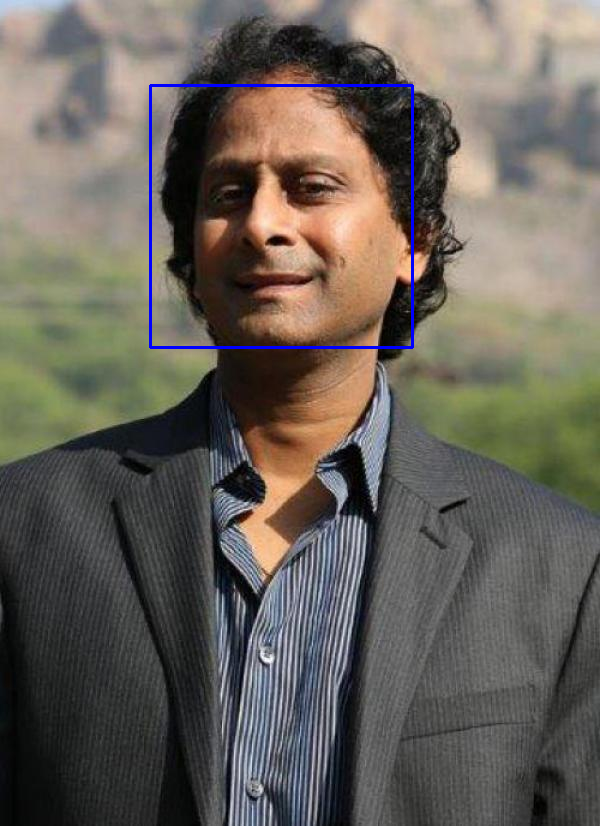

Scott A. Neslin


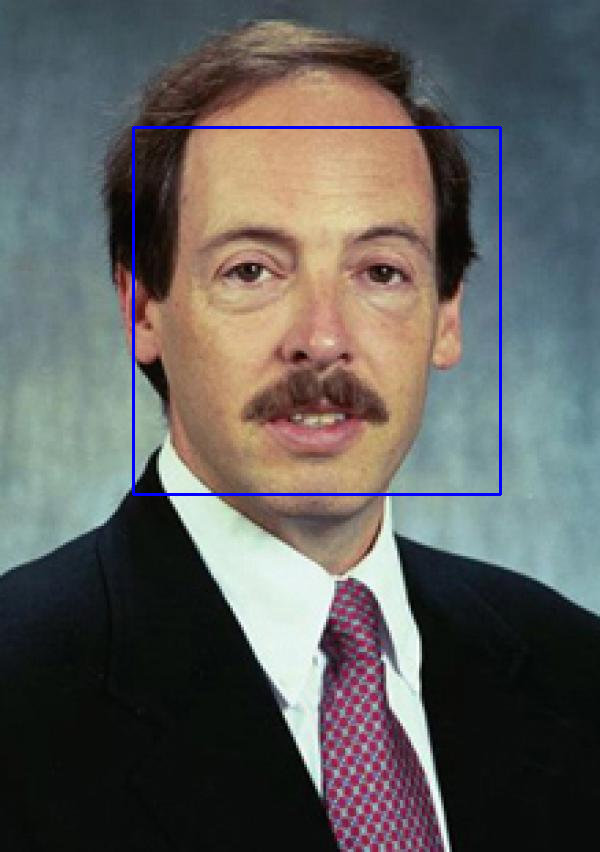

Nailya Ordabayeva


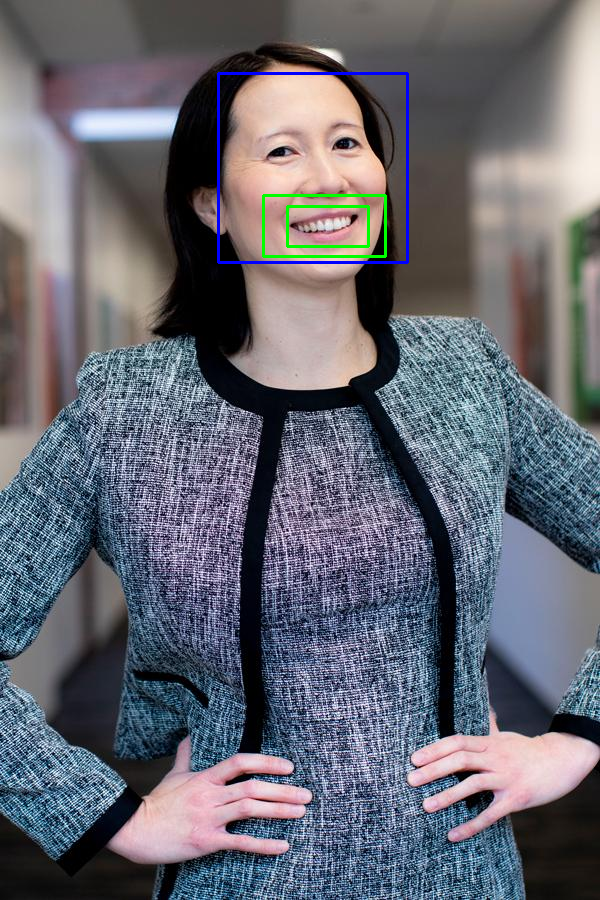

Sharmistha Sikdar


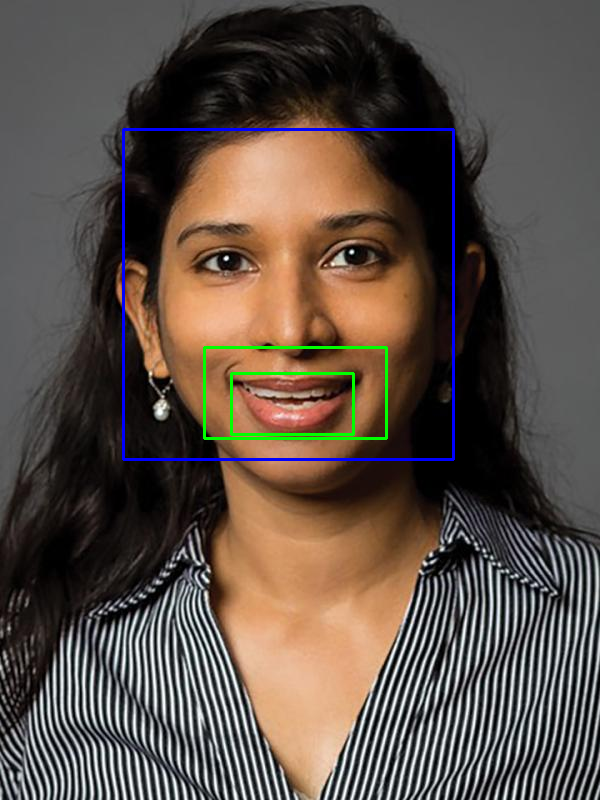

Prasad Vana


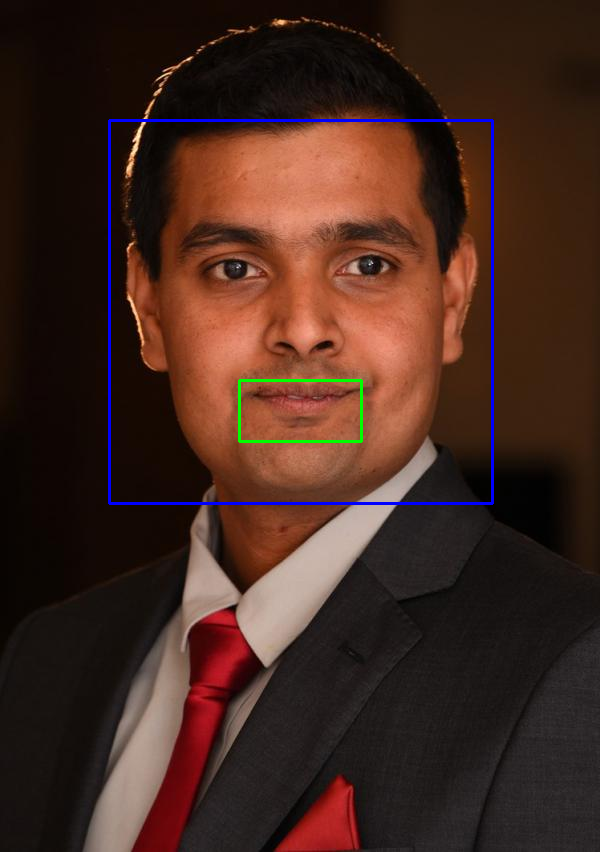

Laurens Debo


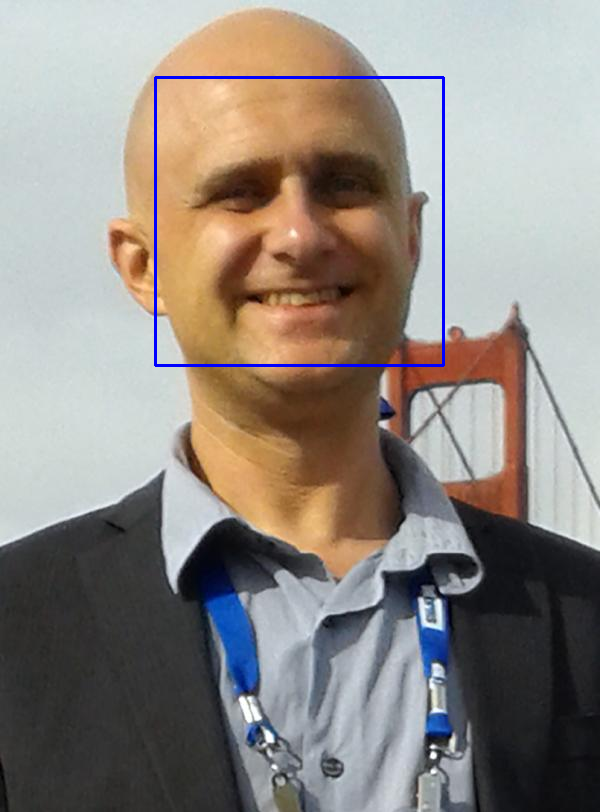

Michelle A. Kinch


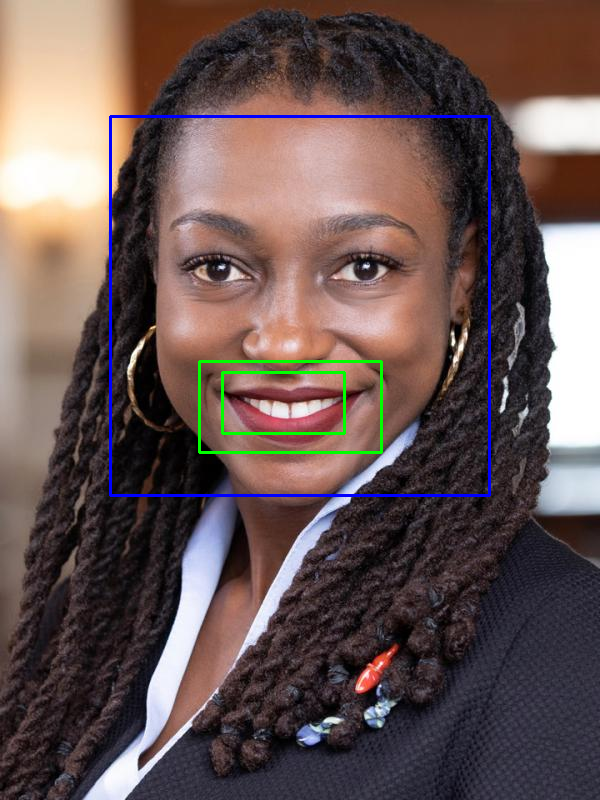

Lauren Lu


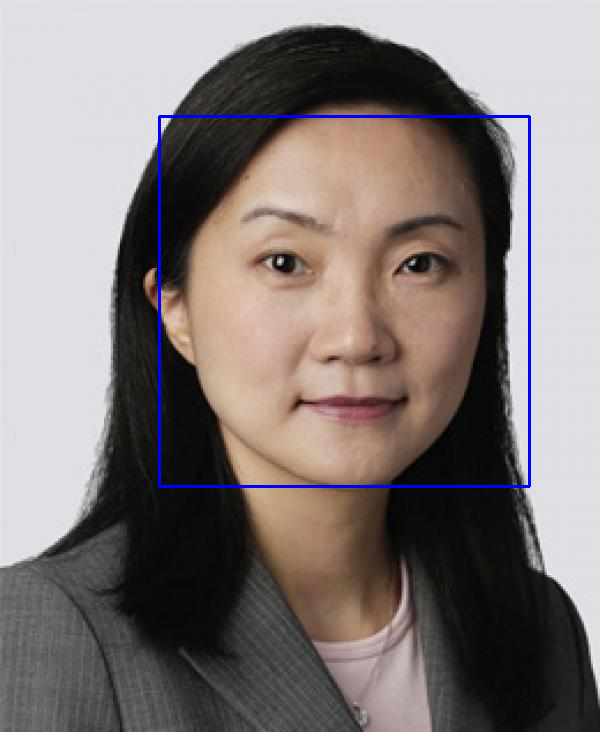

Robert A. Shumsky


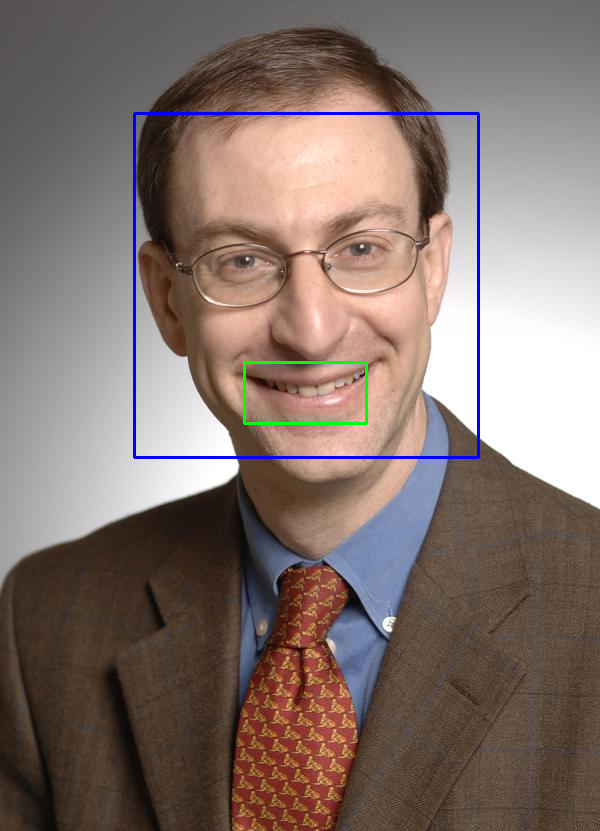

James Siderius


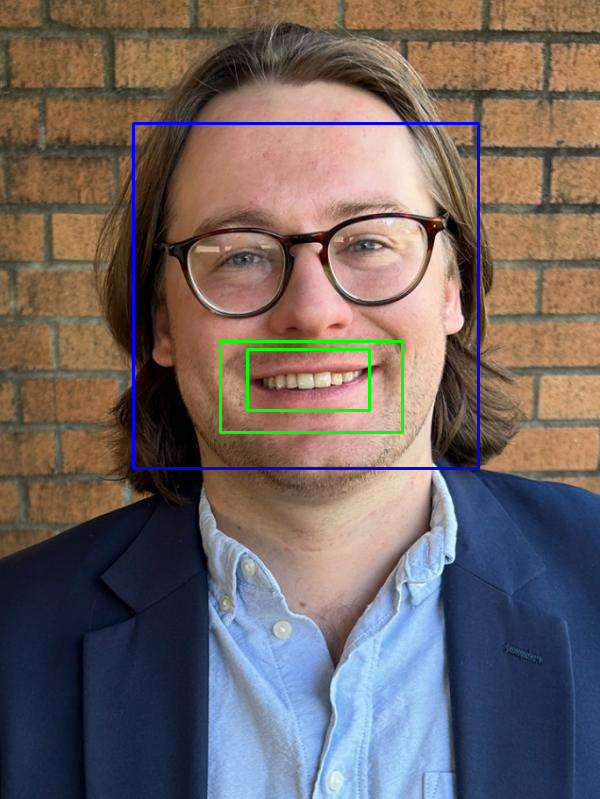

Raghav Singal


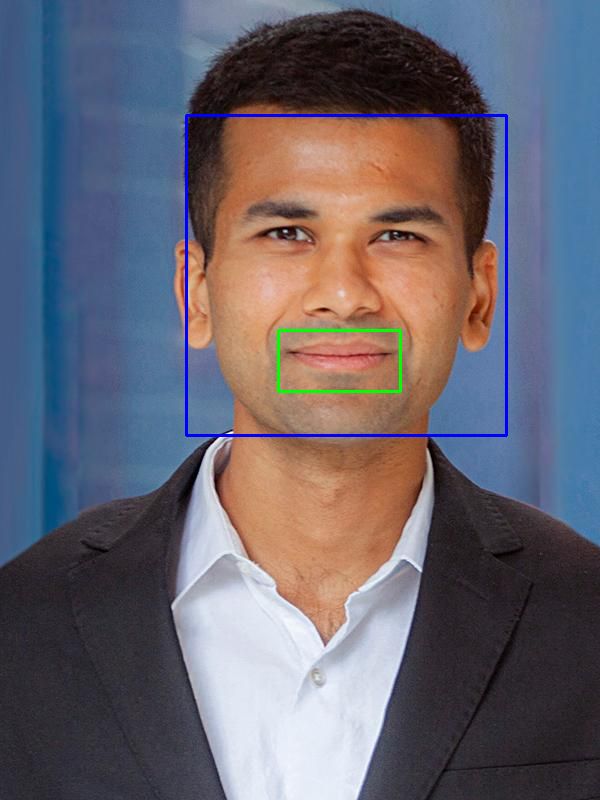

James Smith


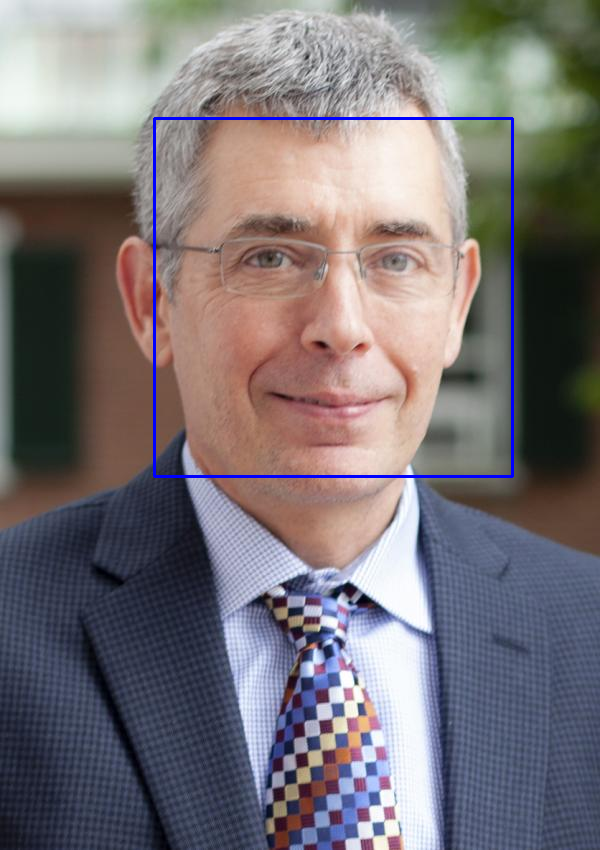

Brian T. Tomlin


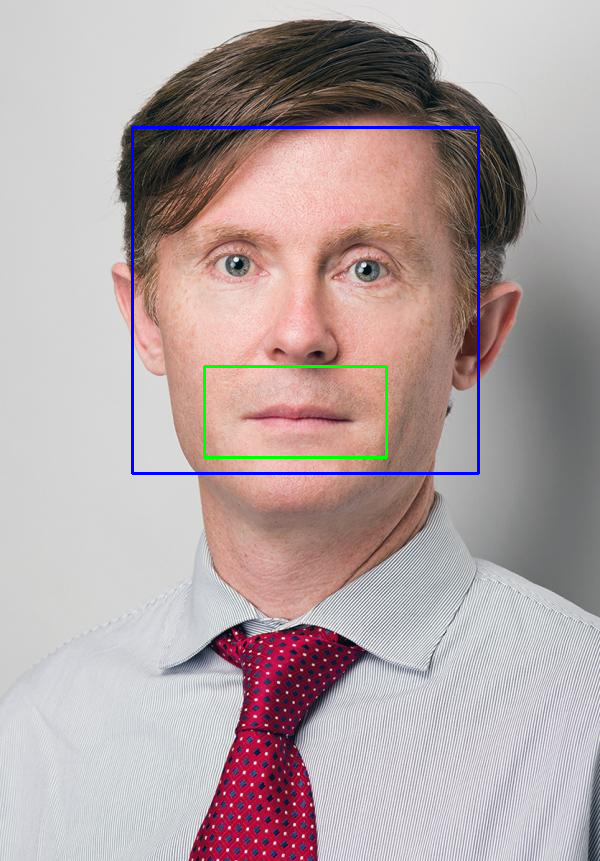

Pino Audia


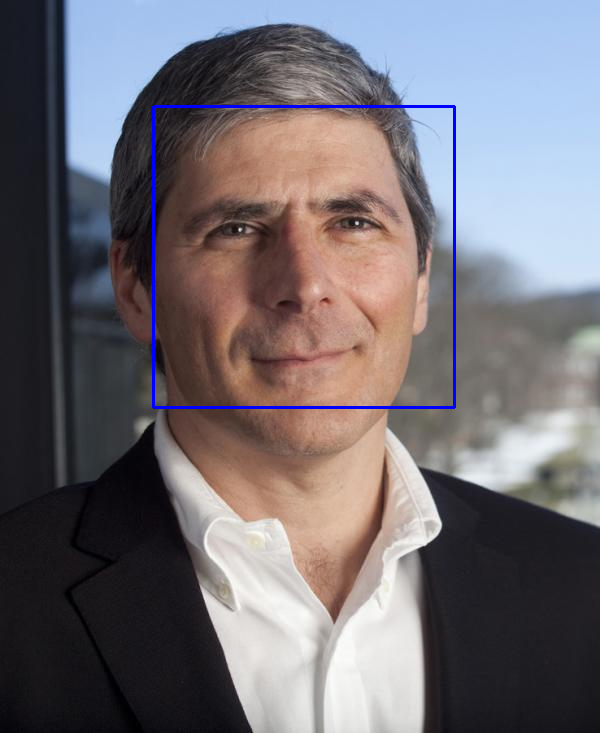

Tianna Barnes


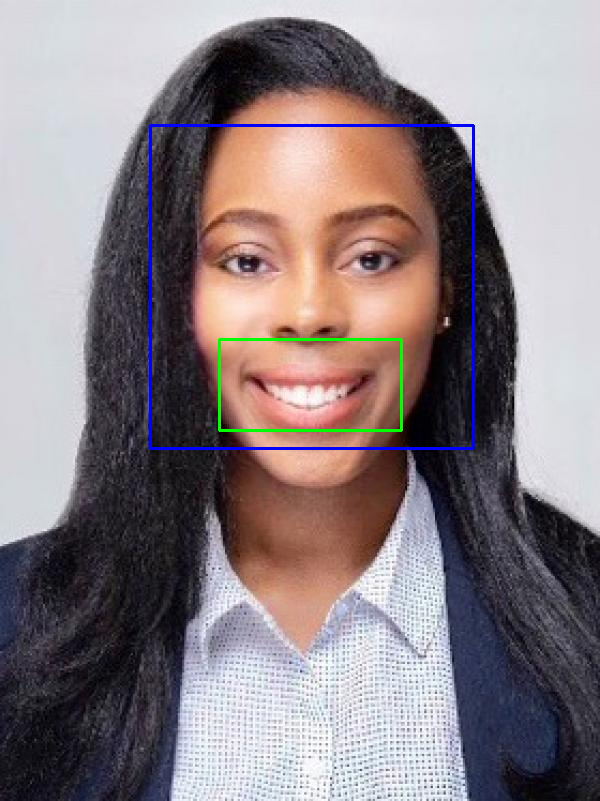

Daniel C. Feiler


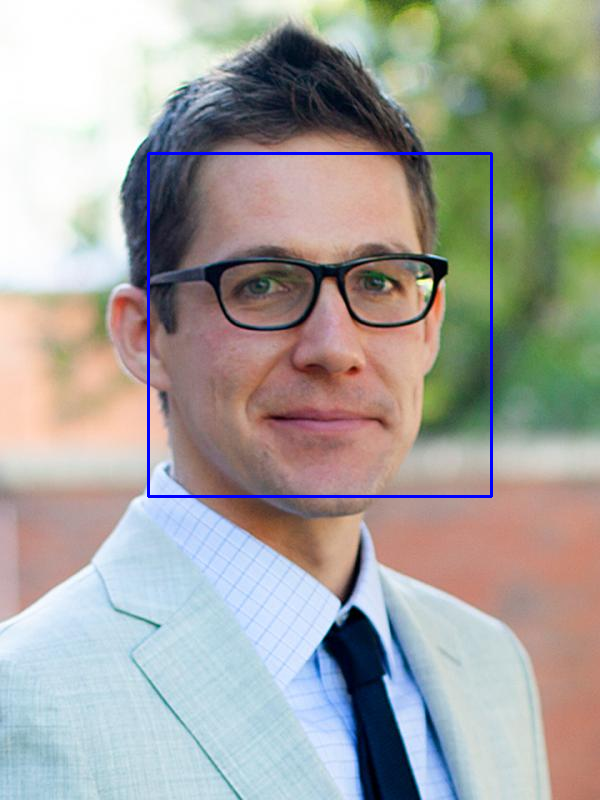

Adam M. Kleinbaum


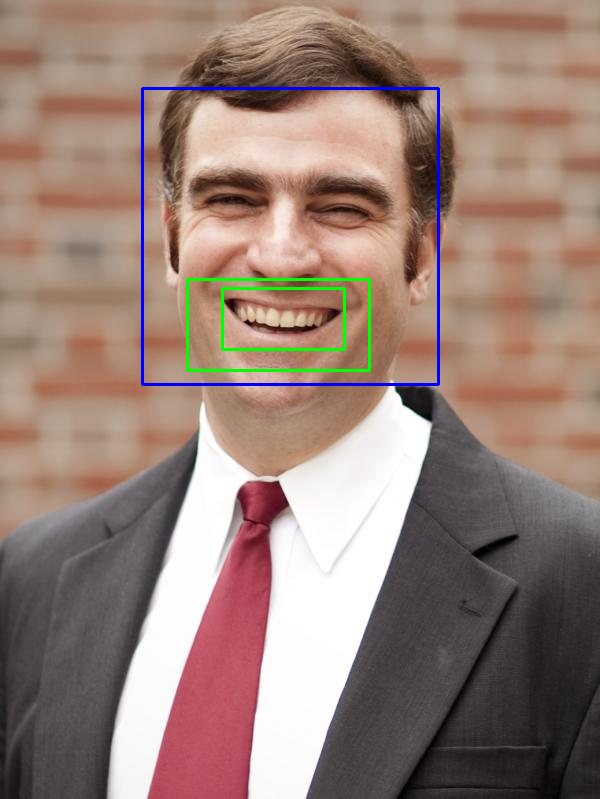

Julia Melin


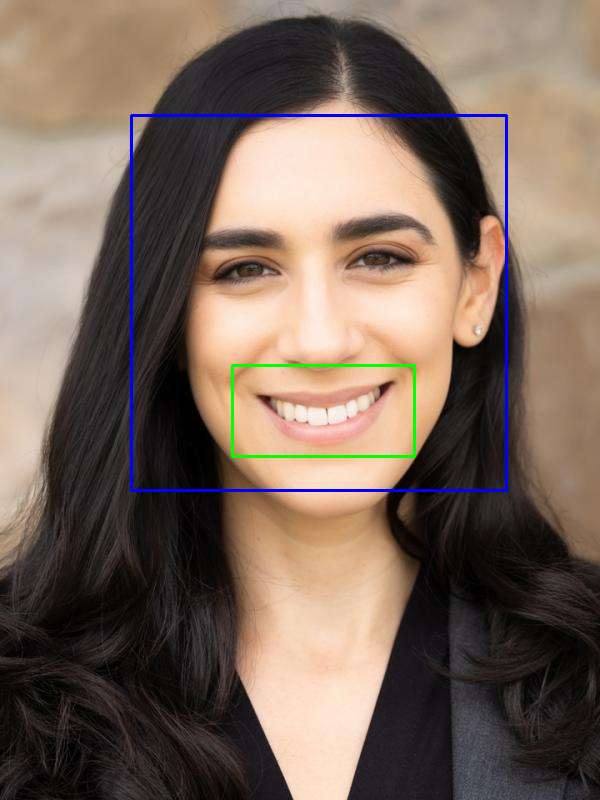

Sonya Mishra 


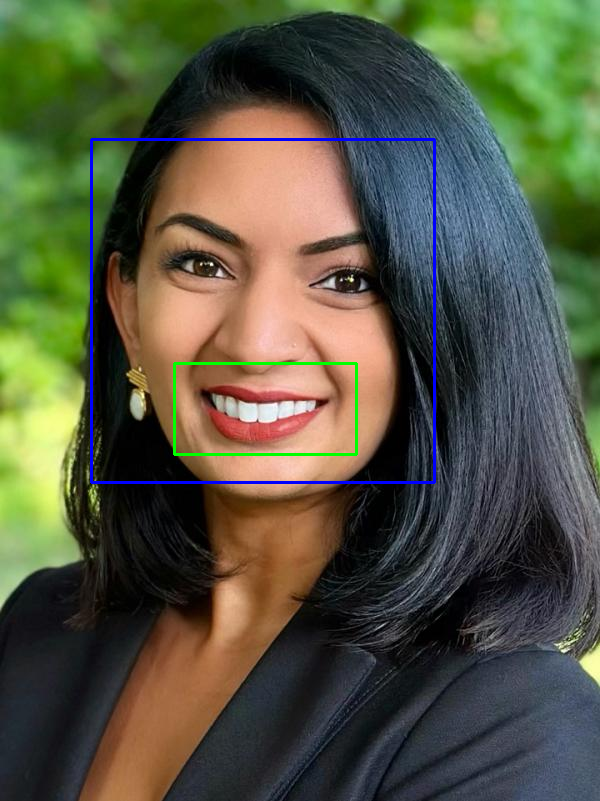

Ron Adner


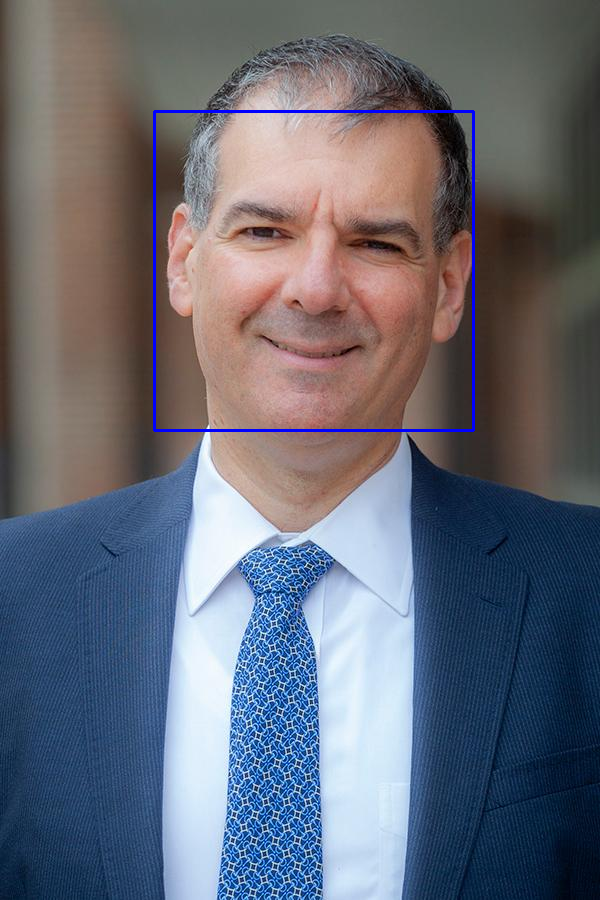

Mark DesJardine


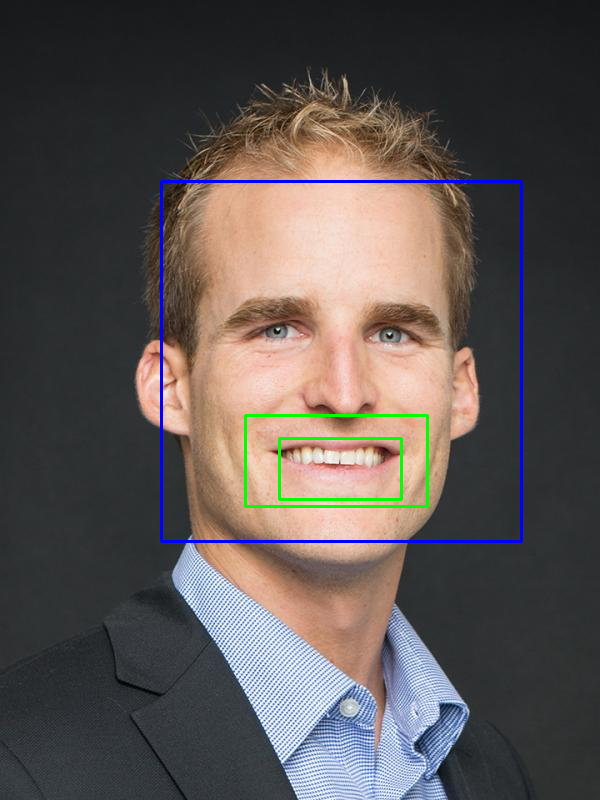

Sydney Finkelstein


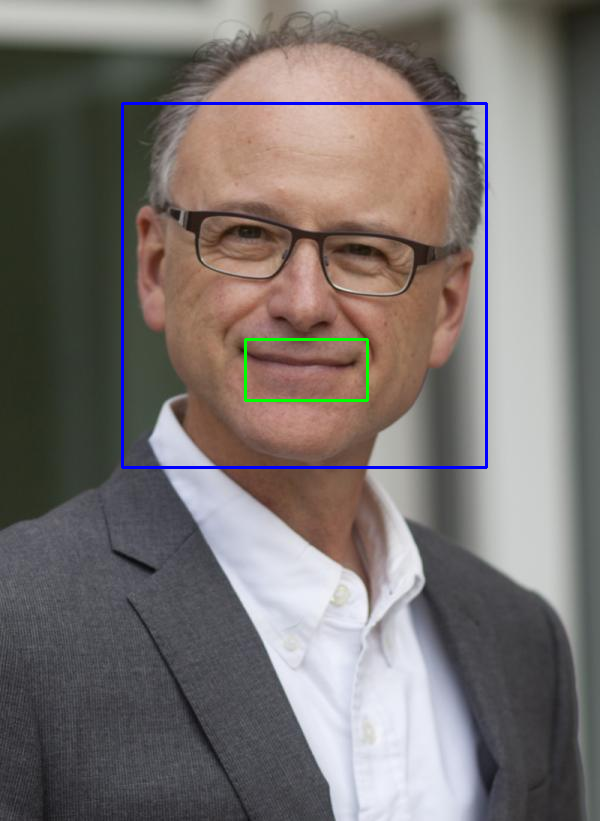

Giovanni Gavetti


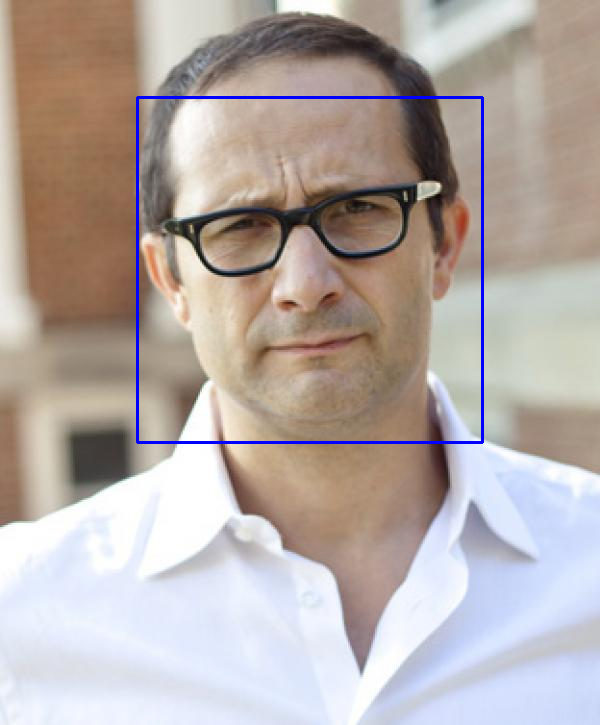

Vijay Govindarajan


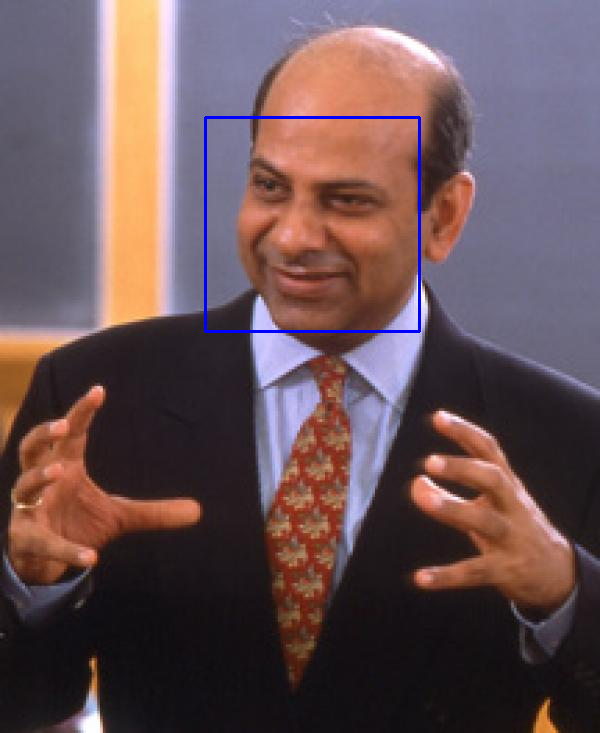

Constance E. Helfat


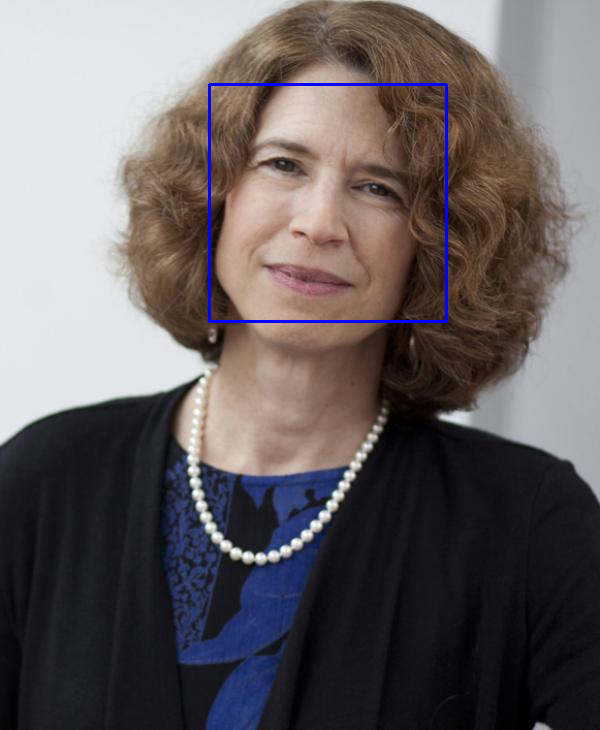

J. Ramon Lecuona Torras


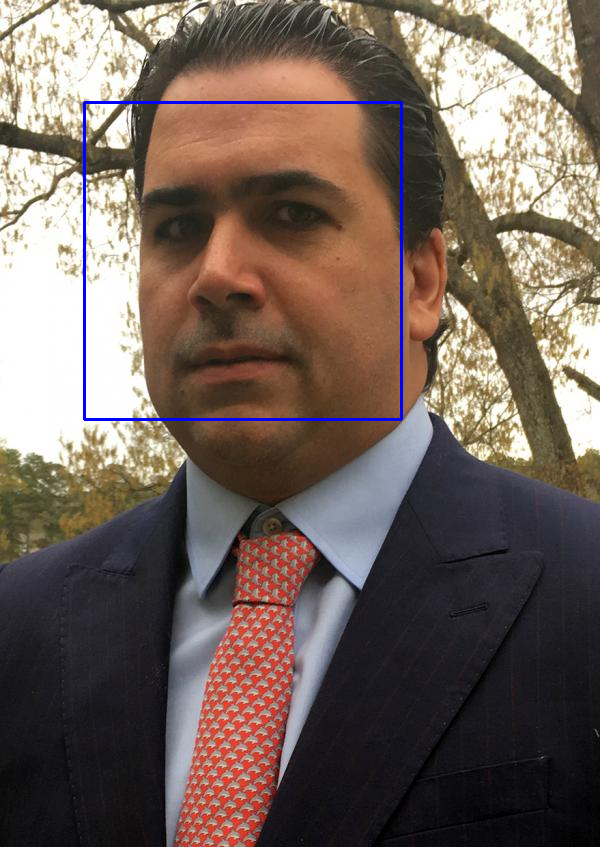

Hart Posen


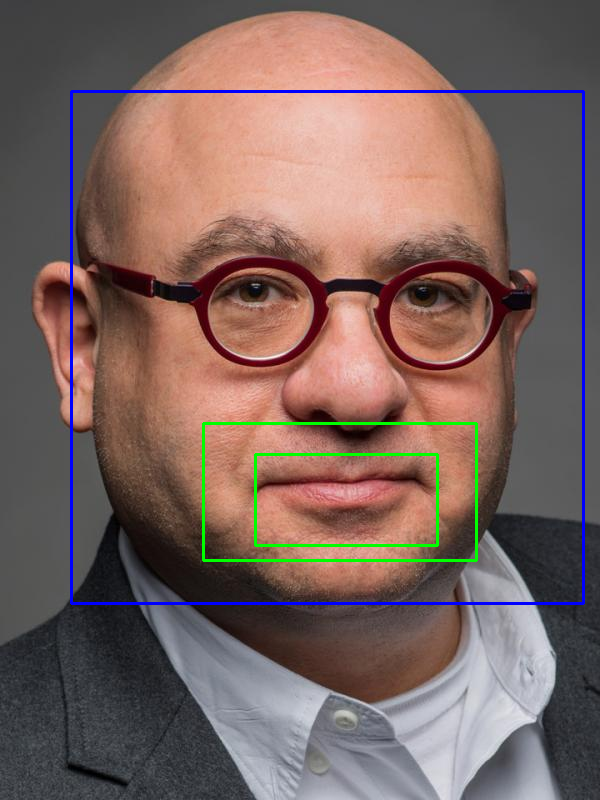

Alva Taylor


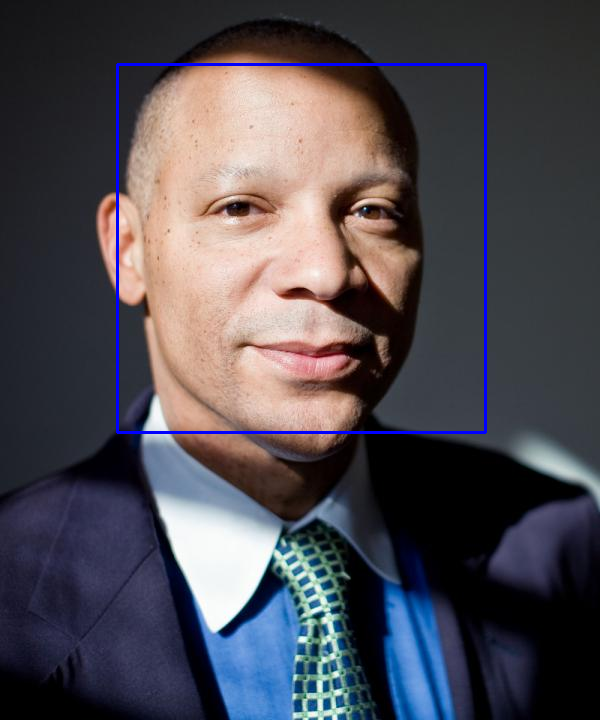

In [15]:
import cv2
from google.colab.patches import cv2_imshow

face_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml')
smile_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_smile.xml')

names = []
face_detected = []
smile_detected = []

for index, row in df_temp.iterrows():
    filename = row["Filename"]
    name = row["Name"]

    img = cv2.imread(f'/content/{filename}', -1)

    faces = face_cascade.detectMultiScale(img, scaleFactor=1.3, minNeighbors=5)

    if len(faces) > 0:
        face_var = 1
    else:
        face_var = 0

    for (x, y, w, h) in faces:
        # Draw rectangle around face
        cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)
        roi_bottom_half = img[y + int(h * 0.6):y + h, x:x + w]

        # Check if the region of interest is not None
        if roi_bottom_half is not None:
            smiles = smile_cascade.detectMultiScale(roi_bottom_half, scaleFactor=1.5, minNeighbors=40)

            if len(smiles) > 0:
                smile_var = 1
            else:
                smile_var = 0

            for (sx, sy, sw, sh) in smiles:
                # Draw rectangle around smile
                cv2.rectangle(img, (x + sx, y + int(h * 0.6) + sy), (x + sx + sw, y + int(h * 0.6) + sy + sh), (0, 255, 0), 2)

            face_detected.append(face_var)
            smile_detected.append(smile_var)
            names.append(name)


            print(name)
            cv2_imshow(img)
            cv2.waitKey(0)
            cv2.destroyAllWindows()




In [16]:
print(len(face_detected))
print(len(smile_detected))
print(len(names))

54
54
54


In [17]:
df_meta_prof2.head()

,Department,Name,Title,URL,Biography,Pronouns,Sex
0,accounting,Joseph J. Gerakos D’90,Bakala Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...,Joseph Gerakos studies markets for financial s...,[he],Male
1,accounting,Leslie A. Robinson,Professor of Business Administration,https://www.tuck.dartmouth.edu/faculty/faculty...,Leslie Robinson teaches financial accounting i...,"[she, her, her]",Female
2,accounting,Richard C. Sansing,Noble Foundation Professor of Accounting,https://www.tuck.dartmouth.edu/faculty/faculty...,Richard Sansing is the Noble Foundation Profes...,"[he, he, he, his]",Male
3,accounting,Phillip C. Stocken,Jack Byrne Professor of Accounting; Area Chair...,https://www.tuck.dartmouth.edu/faculty/faculty...,Phil Stocken specializes in accounting and bus...,"[he, he]",Male
4,economics,Andrew B. Bernard,Kadas T'90 Distinguished Professor,https://www.tuck.dartmouth.edu/faculty/faculty...,Professor Bernard is an expert in internationa...,"[he, his]",Male


In [18]:
df_smile = pd.DataFrame({"Name":names,
                         "Face":face_detected,
                         "Smile":smile_detected
                         })

df_smile.head()

,Name,Face,Smile
0,Leslie A. Robinson,1,1
1,Richard C. Sansing,1,1
2,Phillip C. Stocken,1,1
3,Andrew B. Bernard,1,1
4,Emily J. Blanchard,1,0


In [19]:
df_smile["Smile"].value_counts()

1    33
0    21
Name: Smile, dtype: int64

In [20]:
df_smile["Face"].value_counts()

1    54
Name: Face, dtype: int64

In [21]:
df_result = df_meta_prof2.merge(df_smile, on="Name")

In [22]:
import numpy as np

conditions = [
    df_result["Title"].str.contains("Emeritus"),
    df_result["Title"].str.contains("Emerita"),
    df_result["Title"].str.contains("Assistant"),
    df_result["Title"].str.contains("Associate")
]

choices = ["Emeritus", "Emeritus", "Assistant", "Associate"]

df_result["Rank"] = np.select(conditions, choices, default="Full")

df_result["Rank"].value_counts()

Full         30
Associate    14
Assistant    10
Name: Rank, dtype: int64

In [23]:
df_result["Title"].value_counts()

Assistant Professor of Business Administration                                                                        9
Associate Professor of Business Administration                                                                        8
Professor of Business Administration                                                                                  2
Associate Professor of Business Administration                                                                        1
Associate Professor of Business Administration; Paul E. Raether T’73 Faculty Fellow                                   1
Professor of Operations Management; Area Chair, Operations and Management Science                                     1
Professor of Operations Management; Co-Faculty Director, Master of Health Care Delivery Science                       1
Assistant Professor of Business Administration; Wei-Chung Bradford Hu T’89 Faculty Fellow                             1
Jack Byrne Distinguished Professor in De

In [24]:
df_result["University"] = "Dartmouth"

df_result = df_result[["University","Name","Department","Rank","Sex","Title","Pronouns","URL","Face","Smile"]]

In [25]:
df_result.to_csv("Dartmouth_meta_smile.csv", index=False)



# Statistical Test

In [26]:
df = df_result
df["Face"].value_counts()

df = df[df["Sex"] != "Unknown"]

#df = df[df["Department"] != "services-management"]
#df = df[df["Rank"] != "Emeritus"]

df["Department"].value_counts()

finance                          10
marketing                        10
strategy-and-management           9
economics                         8
operations-management-science     8
organizational-behavior           6
accounting                        3
Name: Department, dtype: int64

In [27]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df['Sex'], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile    0   1
Sex           
Female   3  12
Male    18  21 

Chi-square statistic: 2.114685314685315
P-value: 0.1458920396020727
Degrees of freedom: 1
Expected frequencies:
[[ 5.83333333  9.16666667]
 [15.16666667 23.83333333]]


In [28]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab(df['Rank'], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile       0   1
Rank             
Assistant   3   7
Associate   4  10
Full       14  16 

Chi-square statistic: 1.7231910946196662
P-value: 0.42248744554624895
Degrees of freedom: 2
Expected frequencies:
[[ 3.88888889  6.11111111]
 [ 5.44444444  8.55555556]
 [11.66666667 18.33333333]]


In [29]:
from scipy.stats import chi2_contingency

contingency_table = pd.crosstab([df['Rank'], df["Sex"]], df['Smile'])
print(contingency_table, "\n")

chi2, p, dof, expected = chi2_contingency(contingency_table)

print(f"Chi-square statistic: {chi2}")
print(f"P-value: {p}")
print(f"Degrees of freedom: {dof}")
print("Expected frequencies:")
print(expected)

Smile              0   1
Rank      Sex           
Assistant Female   0   5
          Male     3   2
Associate Female   1   3
          Male     3   7
Full      Female   2   4
          Male    12  12 

Chi-square statistic: 6.101298701298702
P-value: 0.2964865610828576
Degrees of freedom: 5
Expected frequencies:
[[ 1.94444444  3.05555556]
 [ 1.94444444  3.05555556]
 [ 1.55555556  2.44444444]
 [ 3.88888889  6.11111111]
 [ 2.33333333  3.66666667]
 [ 9.33333333 14.66666667]]
